# Visualisation of PRISMA hyperspectral data

1. Load netCDF file
2. Concatenate bands into single array with correct wavelength coordinates
3. Create interactive visualisation of
    - Image with bands selector (choose R, G, B, alpha)
    - Spectrogram with pixel selector (allow for averaging over surrounding pixels)

In [1]:
import matplotlib.pyplot as plt
import numpy as np
import xarray as xr
import rasterio as rio

## Load netCDF file

In [2]:
# read netCDF file using dask (parallel=True)
fname_in = "/mnt/c/Users/townend/Documents/data/PRISMA/PRS_L2D_STD_20210416191440_20210416191444_0001.nc"
ds = xr.open_mfdataset(fname_in, engine="h5netcdf", parallel=True)
ds

<xarray.Dataset>
Dimensions:                                                         (1: 1, 256: 256, 3: 3, path: 1120, t: 1000, wl_swir: 173, wl_vnir: 66, x: 1230, x_pc: 7380, y: 1212, y_pc: 7272)
Coordinates:
  * wl_swir                                                         (wl_swir) float32 ...
  * wl_vnir                                                         (wl_vnir) float32 ...
Dimensions without coordinates: 1, 256, 3, path, t, x, x_pc, y, y_pc
Data variables: (12/70)
    HDFEOS-SWATHS-PRS_L2D_HCO-Data Fields-SWIR_Cube                 (y, wl_swir, x) uint16 dask.array<chunksize=(1212, 173, 1230), meta=np.ndarray>
    HDFEOS-SWATHS-PRS_L2D_HCO-Data Fields-SWIR_PIXEL_L2_ERR_MATRIX  (y, wl_swir, x) uint8 dask.array<chunksize=(1212, 173, 1230), meta=np.ndarray>
    HDFEOS-SWATHS-PRS_L2D_HCO-Data Fields-VNIR_Cube                 (y, wl_vnir, x) uint16 dask.array<chunksize=(1212, 66, 1230), meta=np.ndarray>
    HDFEOS-SWATHS-PRS_L2D_HCO-Data Fields-VNIR_PIXEL_L2_ERR_MATRIX  (y, wl_vnir, x) uint8 dask.array<chunksize=(1212, 66, 1230), meta=np.ndarray>
    HDFEOS-SWATHS-PRS_L2D_HCO-Geolocation Fields-Latitude           (y, x) float64 dask.array<chunksize=(1212, 1230), meta=np.ndarray>
    HDFEOS-SWATHS-PRS_L2D_HCO-Geolocation Fields-Longitude          (y, x) float64 dask.array<chunksize=(1212, 1230), meta=np.ndarray>
    ...                                                              ...
    KDP_AUX-Cw_Swir_Matrix                                          (t, 256) float32 dask.array<chunksize=(1000, 256), meta=np.ndarray>
    KDP_AUX-Cw_Vnir_Matrix                                          (t, 256) float32 dask.array<chunksize=(1000, 256), meta=np.ndarray>
    KDP_AUX-Fwhm_Swir_Matrix                                        (t, 256) float32 dask.array<chunksize=(1000, 256), meta=np.ndarray>
    KDP_AUX-Fwhm_Vnir_Matrix                                        (t, 256) float32 dask.array<chunksize=(1000, 256), meta=np.ndarray>
    KDP_AUX-LOS_Swir                                                (t, 3) float32 dask.array<chunksize=(1000, 3), meta=np.ndarray>
    KDP_AUX-LOS_Vnir                                                (t, 3) float32 dask.array<chunksize=(1000, 3), meta=np.ndarray>
Attributes: (12/119)
    Acquisition_Purpose:                NOT SPECIAL PRODUCT
    Acquisition_Size:                   30 Km
    Acquisition_Station:                CNM
    Acquisition_Type:                   EARTH OBSERVATION
    Atm_LutGeomInfo_RelativeAzimuth:    ['RAA_050' 'RAA_085']
    Atm_LutGeomInfo_SunZenith:          ['SZA_035' 'SZA_050']
    ...                                 ...
    VNIRCorruptedFrameList:             [1 1 1 ... 0 0 0]
    VNIR_BNSTART:                       [255]
    VNIR_BNSTOP:                        [0]
    VNIR_Corrupted_Frame_Percentage:    00.20 %
    VNIR_HGRP:                          [1]
    VNIR_X:                             [0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 ...

## Concatenate bands

In [3]:
# create dimension and coordinates for merged SWIR & VNIR wavelengths
# replace "0" wavelengths with random negative numbers to avoid
# duplicate coordinate errors
list_cw = {}
for wl_set in ["List_Cw_Swir", "List_Cw_Vnir"]:
    wls = ds.attrs[wl_set].copy()
    zero_count = len(wls) - np.count_nonzero(wls)
    wls[wls == 0] = -np.random.rand(zero_count)
    list_cw[wl_set] = wls

wls = np.concatenate(list(list_cw.values()))
ds['List_Cw'] = xr.DataArray(wls, dims='wl', coords=(wls,)) 
ds['List_Cw'].shape

(239,)

In [4]:
# concatenate bands into new dataarray
shp = ds['HDFEOS-SWATHS-PRS_L2D_HCO-Data Fields-VNIR_Cube'].shape
ds['cube'] = xr.DataArray(np.concatenate([ds['HDFEOS-SWATHS-PRS_L2D_HCO-Data Fields-SWIR_Cube'],
                                          ds['HDFEOS-SWATHS-PRS_L2D_HCO-Data Fields-VNIR_Cube']],
                                         axis=1), 
                         dims=('y', 'wl', 'x'), coords={'y':range(shp[0]), 'x':range(shp[2])})
ds['cube'].shape

(1212, 239, 1230)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


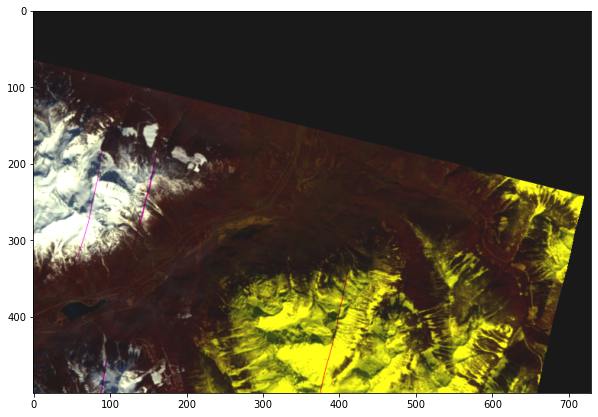

In [5]:
# check data is stored correctly
plt.figure(figsize=(10,10))
img = ds['cube'][:500,[200,220,238],500:].data.swapaxes(1,2)/55000
plt.imshow(img+(1-img)*0.1)

## Create interactive visualisation

Use Holoview to interactive with the hyperspectral cube. Two visualisations created: 

- A "one-liner" with slider for wavelength, to allow for fast data checking. 
- A spectrogram linked to cube viewer, which allows:
    - The wavelengths displayed in the cube to be controlled by the spectrogram (simply select the wavelengths of interest and the mean radiance over these wavelengths will be shown in the image) 
    - The pixel shown in the spectrogram to be controlled by clicking a location in the image

In [6]:
import panel as pn
import hvplot.pandas  # noqa
import hvplot.xarray
import holoviews as hv
from holoviews import streams

In [7]:
# simple cube explorer
# use the slider to change the band shown (wavelength is band centre)
ds.cube.hvplot(groupby='wl', width=900, height=800, cmap='viridis', flip_yaxis=True)

:DynamicMap   [wl]
   :Image   [x,y]   (cube)

In [8]:
# linked spectrogram-cube visualisation
# select a range of wavelengths on the spectro to control the wavelengths shown in the image
# click on the image to control the pixel shown in the spectrogram
# inspired by https://holoviz.org/tutorial/Interlinked_Plots.html

# spectrogram plot properties
wl_lim = [float(wl.data) for wl in [ds.wl[ds.wl>0].min(), ds.wl.max()]]
radiance_lim = [0, float(ds.cube.quantile(0.999).data)]
params = dict(width=900, height=150, xlim=wl_lim, ylim=radiance_lim)
opts = dict(default_tools=[])

def cube_callback(boundsx):
    """
    callback to let box select interaction on spectrogram 
    controls whichs wavelengths are displayed in image
    """
    if not boundsx:
        wlmin, wlmax = wl_lim
    else:
        wlmin, wlmax = boundsx
    subcube = ds.cube.sel(wl=ds.wl[(ds.wl>wlmin) * (ds.wl<wlmax)])
    return subcube.mean(dim='wl').hvplot.image(width=900, height=800, 
                                               cmap='viridis', flip_yaxis=True)

def spect_callback(x, y):
    """
    callback to let tap interaction on image control which pixel is 
    displayed on the spectrogram
    """
    if (not y) and (not x):
        x = 600
        y = 600
    radiances = ds.cube[int(y),:,int(x)].sortby('wl')
    return (radiances.hvplot.line(**params).opts(**opts) * \
            radiances.hvplot.scatter(**params, c='r', s=5).opts(**opts))

# set up plots and interaction streams, connected to callbacks
# the order of these is important
p_box_select = ds.cube[0,:,0].hvplot.line(**params, line_alpha=0).opts(**opts)
wl_stream = streams.BoundsX(source=p_box_select)
p_cube = hv.DynamicMap(cube_callback, streams=[wl_stream])
xy_stream = streams.Tap(source=p_cube)
p_spect = hv.DynamicMap(spect_callback, streams=[xy_stream])

# create plot
pn.Column(p_spect * p_box_select, p_cube)

Column
    [0] HoloViews(DynamicMap)
    [1] HoloViews(DynamicMap)